In [18]:
#!pip install zarr
#!pip install ipytree
#!pip install opencv-python
#!pip install tensorflow
#!pip install tensorflow-gpu

Defaulting to user installation because normal site-packages is not writeable
  Using cached tensorflow-gpu-2.12.0.tar.gz (2.6 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'error'


  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [44 lines of output]
      Traceback (most recent call last):
        File "C:\Users\pdebasis\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\packaging\requirements.py", line 36, in __init__
          parsed = _parse_requirement(requirement_string)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
        File "C:\Users\pdebasis\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\packaging\_parser.py", line 62, in parse_requirement
          return _parse_requirement(Tokenizer(source, rules=DEFAULT_RULES))
                 ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
        File "C:\Users\pdebasis\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Pytho

In [20]:
import os
import shutil
import numpy as np
import math
import json

import cv2
import tensorflow as tf

from pathlib import Path 

import pandas as pd

import matplotlib.pyplot as plt

import zarr

import util
import tracemalloc

In [3]:
base_directory = Path('C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\')
train_images_directory = os.path.join(base_directory, 'train', 'static', 'ExperimentRuns')
train_json_directory = os.path.join(base_directory, 'train', 'overlay', 'ExperimentRuns')

In [15]:
!rm -rf mask
!rm -rf image
!rm -rf timage

!mkdir image
!mkdir mask
!mkdir timage

'rm' is not recognized as an internal or external command,
operable program or batch file.
'rm' is not recognized as an internal or external command,
operable program or batch file.
'rm' is not recognized as an internal or external command,
operable program or batch file.
A subdirectory or file image already exists.
A subdirectory or file mask already exists.
A subdirectory or file timage already exists.


In [10]:
overlay_names = os.listdir(train_json_directory)

ts_paths = []
for overlay_name in overlay_names:
  ts_paths += [os.path.join(train_json_directory, overlay_name)]

paths = []
for ts_path in ts_paths:
  sub_paths = []
  for dirname, _, filenames in os.walk(ts_path):
    for filename in filenames:
      sub_paths += [os.path.join(dirname, filename)]
    paths += [sub_paths]

paths


[['C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\overlay\\ExperimentRuns\\TS_5_4\\Picks\\apo-ferritin.json',
  'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\overlay\\ExperimentRuns\\TS_5_4\\Picks\\beta-amylase.json',
  'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\overlay\\ExperimentRuns\\TS_5_4\\Picks\\beta-galactosidase.json',
  'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\overlay\\ExperimentRuns\\TS_5_4\\Picks\\ribosome.json',
  'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\overlay\\ExperimentRuns\\TS_5_4\\Picks\\thyroglobulin.json',
  'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\overlay\\ExperimentRuns\\TS_5_4\\Picks\\virus-like-particle.json'],
 ['C:\\Users\\pdebasis\\source\\personal\\project_3\\

In [11]:
json_data = []
for sub_path in paths:
  sub_json_data = []
  for i, path in enumerate(sub_path):
    x = []
    y = []
    z = []
    z2 = []
    data = util.read_json(path)

    for data_points in data['points']:
      x += [data_points['location']['x']]
      y += [data_points['location']['y']]
      z += [data_points['location']['z']]
      z2 += [data_points['location']['z']//50]

    sub_json_data += [(i, x, y, z, z2)]
    
      #sub_json_data.append(data)
  json_data += [sub_json_data]

  #df = util.json_to_df(sub_json_data)
  print(json_data)

[[(0, [468.514, 5674.694, 5744.509, 5880.769, 4661.667, 4593.498, 4569.735, 4524.726, 1072.449, 1068.182, 995.294, 969.749, 1088.28, 1130.0, 891.818, 924.121, 1663.767, 5870.268, 4807.948, 4837.967, 4714.452, 5062.45, 4829.392, 3684.954, 3738.736, 2682.13, 2801.725, 2504.12, 2499.282, 2626.828, 2552.162, 609.824, 521.952, 612.529, 4657.21, 1151.918, 1038.494, 1059.84, 1066.853, 2340.306, 2349.924, 3779.642, 611.797, 557.665, 5715.014, 5748.253], [5915.906, 1114.354, 1049.172, 1125.348, 1269.497, 1195.874, 1249.967, 1359.207, 2963.265, 3024.848, 3029.412, 3086.695, 3115.16, 3130.0, 2977.273, 3210.767, 3311.767, 5131.104, 4949.03, 5049.35, 5064.976, 5082.947, 4473.384, 4537.92, 4124.944, 3630.154, 1630.415, 2311.852, 2197.394, 2295.534, 2711.815, 4421.479, 4275.286, 4271.092, 5130.873, 3210.74, 3201.114, 3172.472, 3207.492, 2283.227, 2329.502, 4198.01, 4393.753, 4367.989, 4998.216, 5115.846], [604.167, 565.068, 653.712, 579.56, 810.409, 877.982, 735.033, 763.445, 384.014, 515.628, 407.89

# Create Mask Images

In [6]:
def mask_image(json_data, i, j):
  fig = plt.figure(figsize=(16, 16))
  ax = fig.add_subplot(111)

  for data in json_data:
    k, x, y, z, z2 = data
    filtered_indices = [idx for idx, z in enumerate(z2) if z==j]

    filtered_x = [x[idx] for idx in filtered_indices]
    filtered_y = [y[idx] for idx in filtered_indices]
    filtered_z2 = [z2[idx] for idx in filtered_indices]

    scatter = ax.scatter(filtered_x, filtered_y, c=[k] * len(filtered_x), vmin=0, vmax=5, cmap='viridis')

  ax.set_xlabel('X Label')
  ax.set_xlabel('Y Label')

  plt.axis('off')
  plt.savefig(f'mask/{i}_{j:02}.png', bbox_inches='tight', pad_inches=0)

  plt.show()

In [5]:
for i, data in enumerate(json_data):
  for j in range(32):
    print(i, j)
    mask_image(data, i, j)

NameError: name 'json_data' is not defined

# Create Train Images

['C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_5_4\\VoxelSpacing10.000', 'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_69_2\\VoxelSpacing10.000', 'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_6_4\\VoxelSpacing10.000', 'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_6_6\\VoxelSpacing10.000', 'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_73_6\\VoxelSpacing10.000', 'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_86_3\\VoxelSpacing10.000', 'C:\\Users\\pdebasis\\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRu

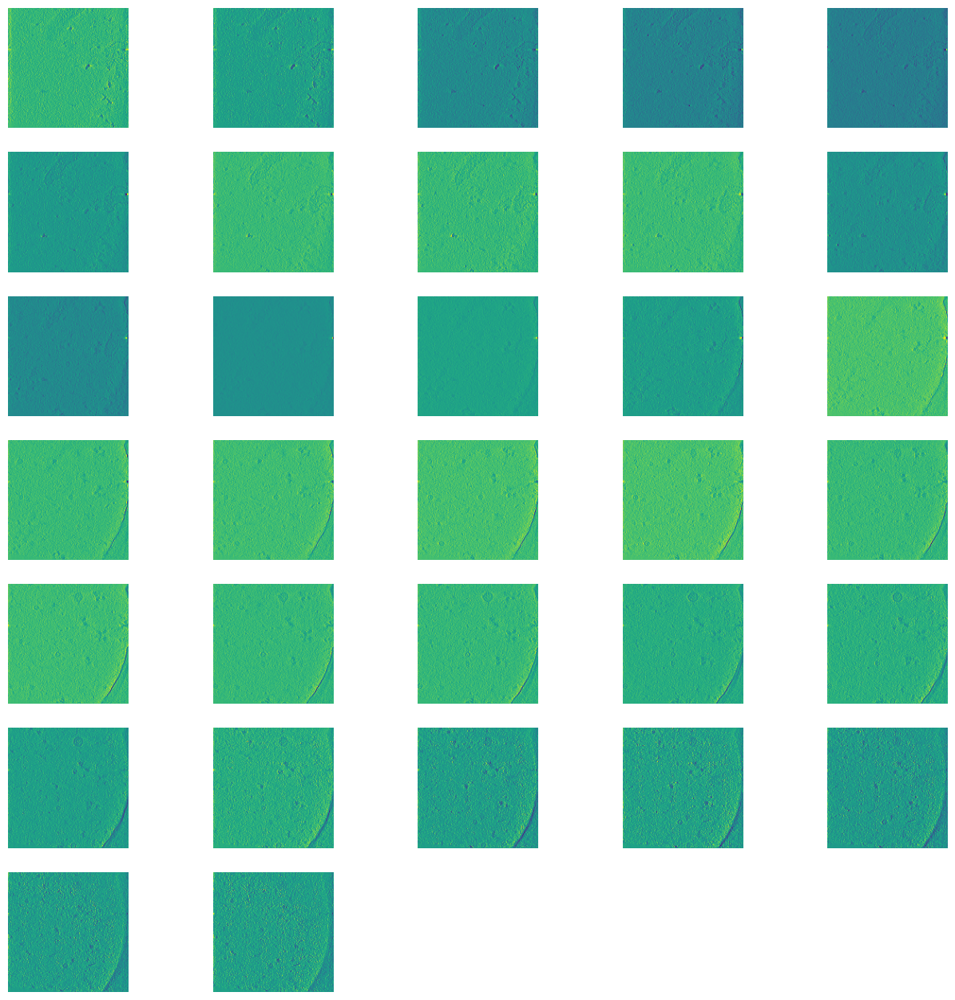

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_69_2\VoxelSpacing10.000\ctfdeconvolved.zarr


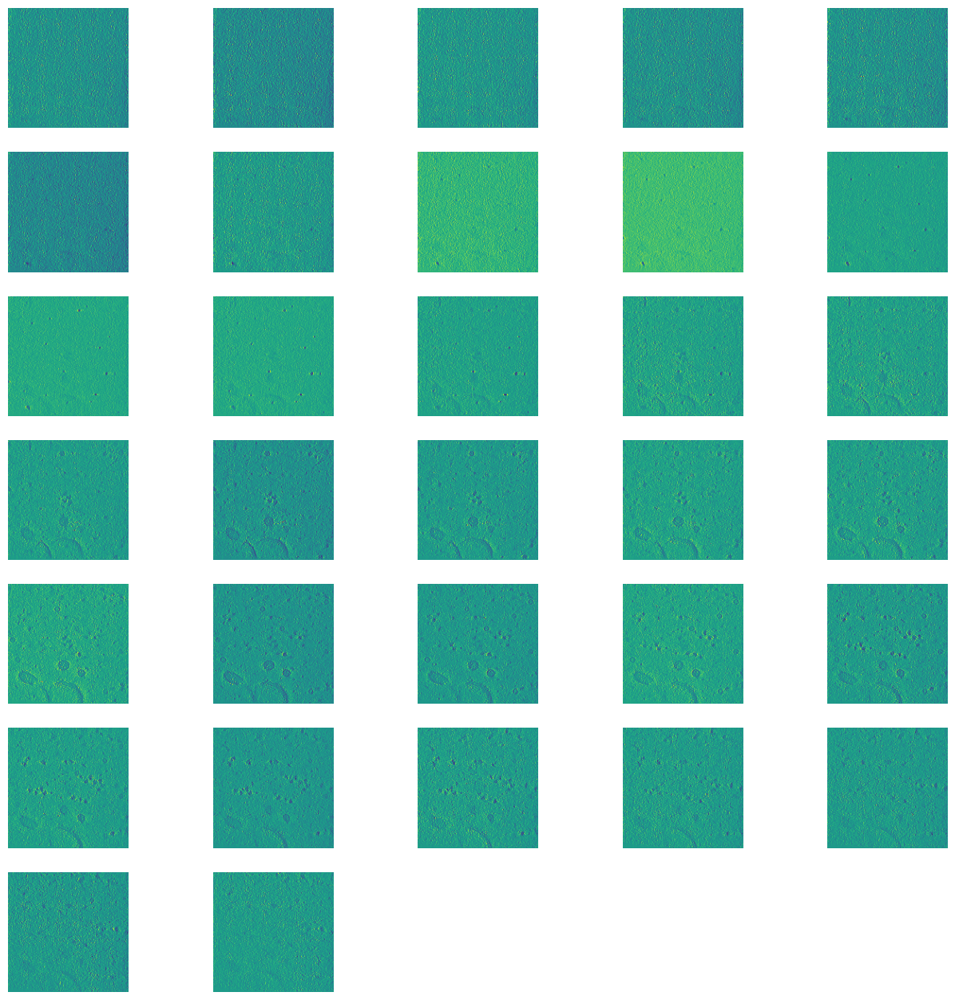

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_6_4\VoxelSpacing10.000\ctfdeconvolved.zarr


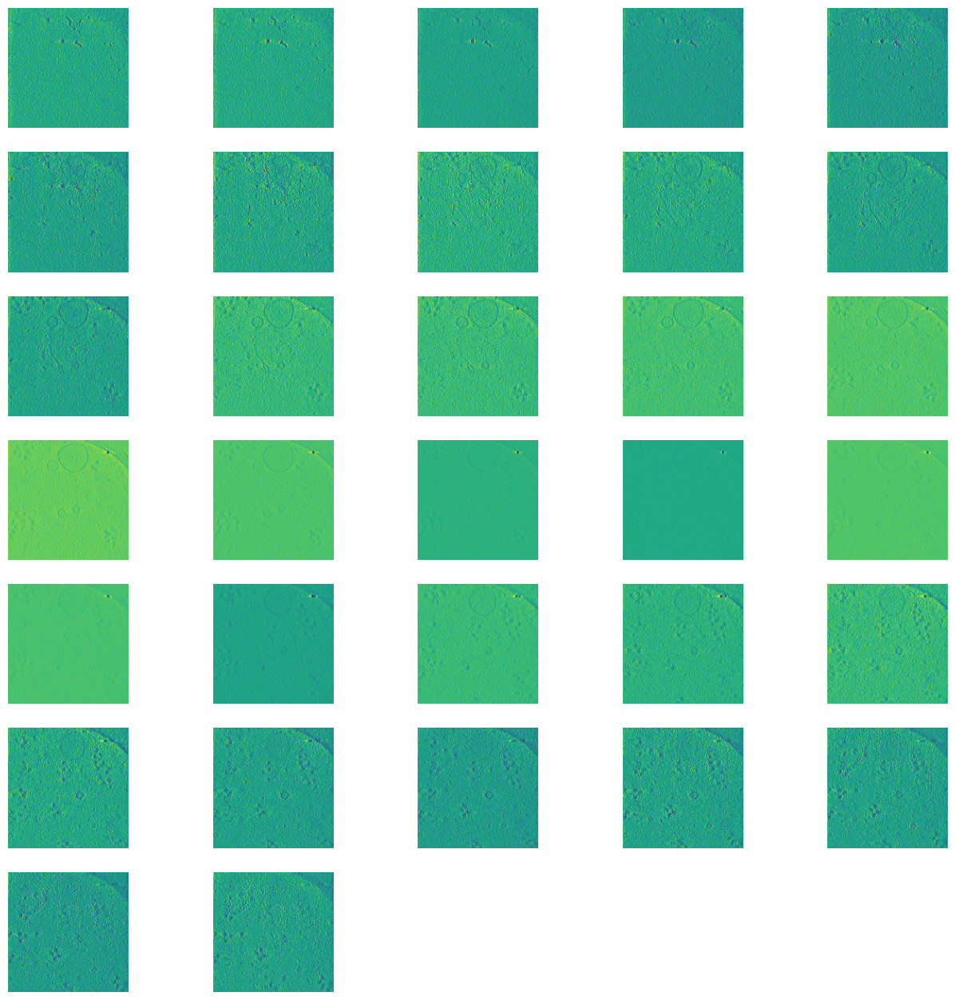

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_6_6\VoxelSpacing10.000\ctfdeconvolved.zarr


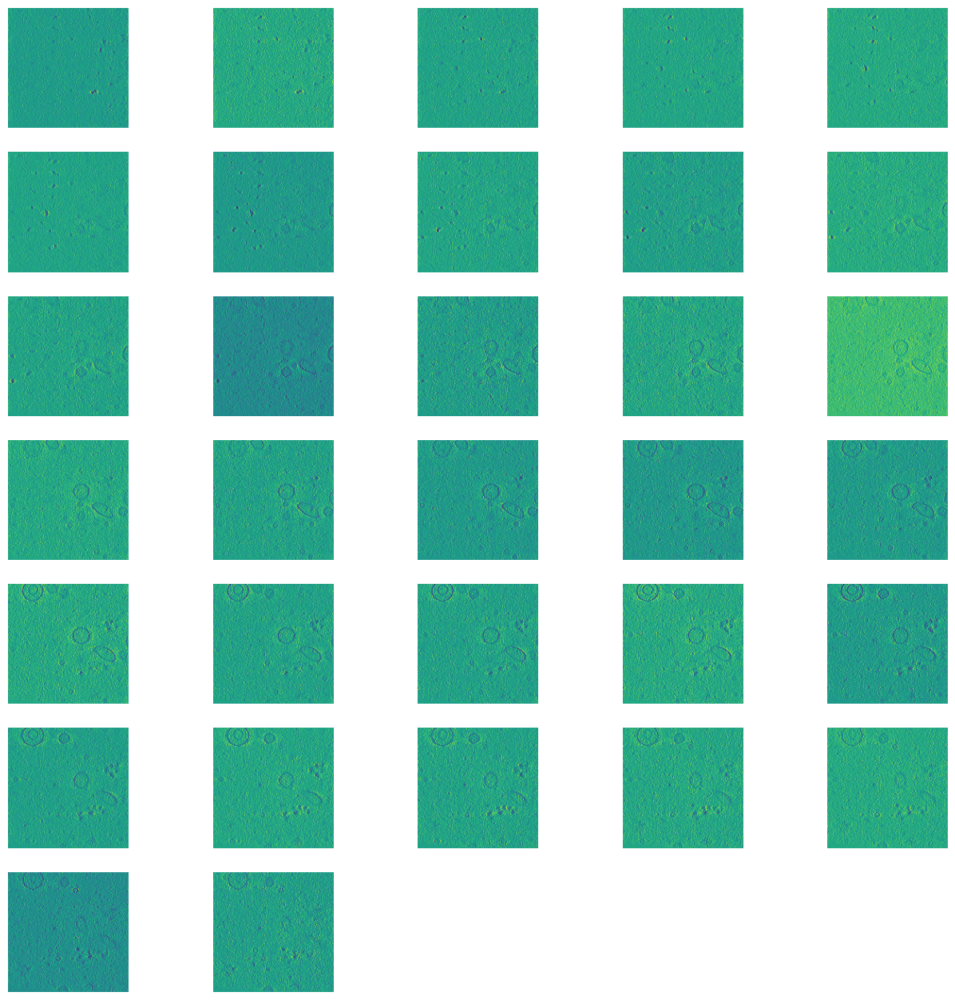

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_73_6\VoxelSpacing10.000\ctfdeconvolved.zarr


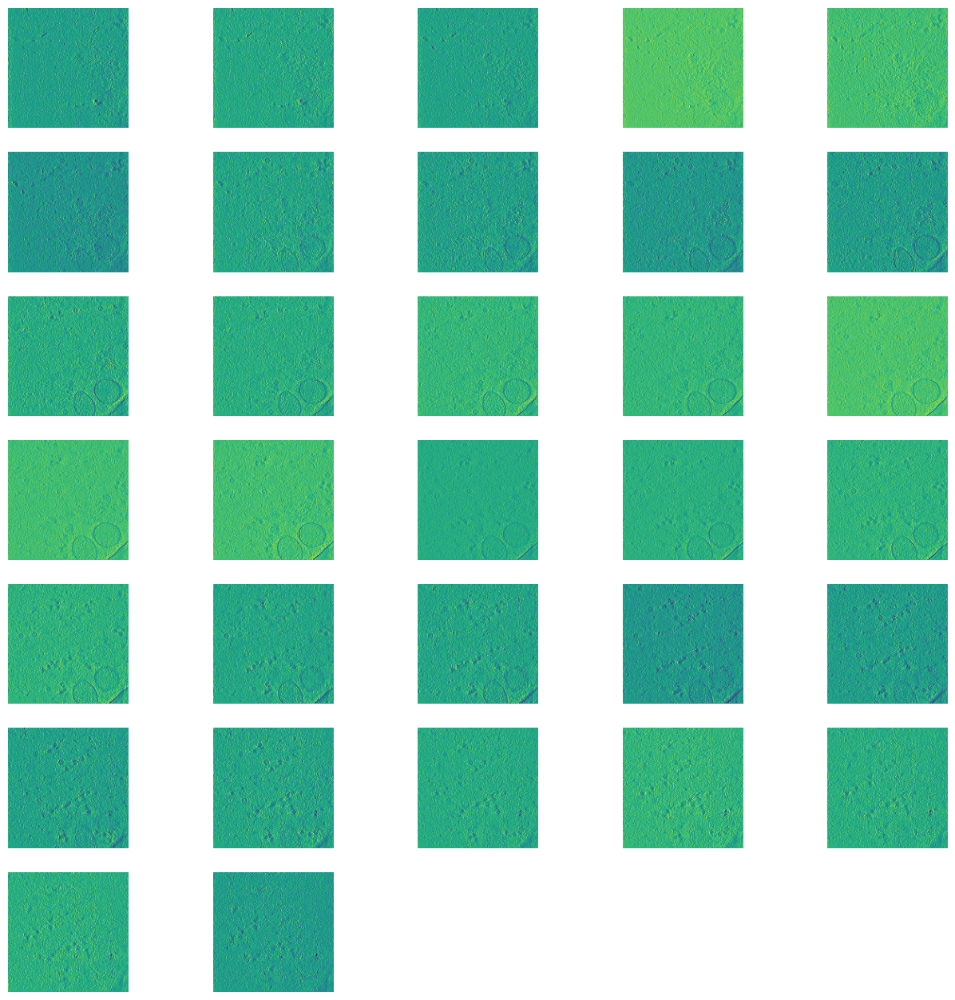

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_86_3\VoxelSpacing10.000\ctfdeconvolved.zarr


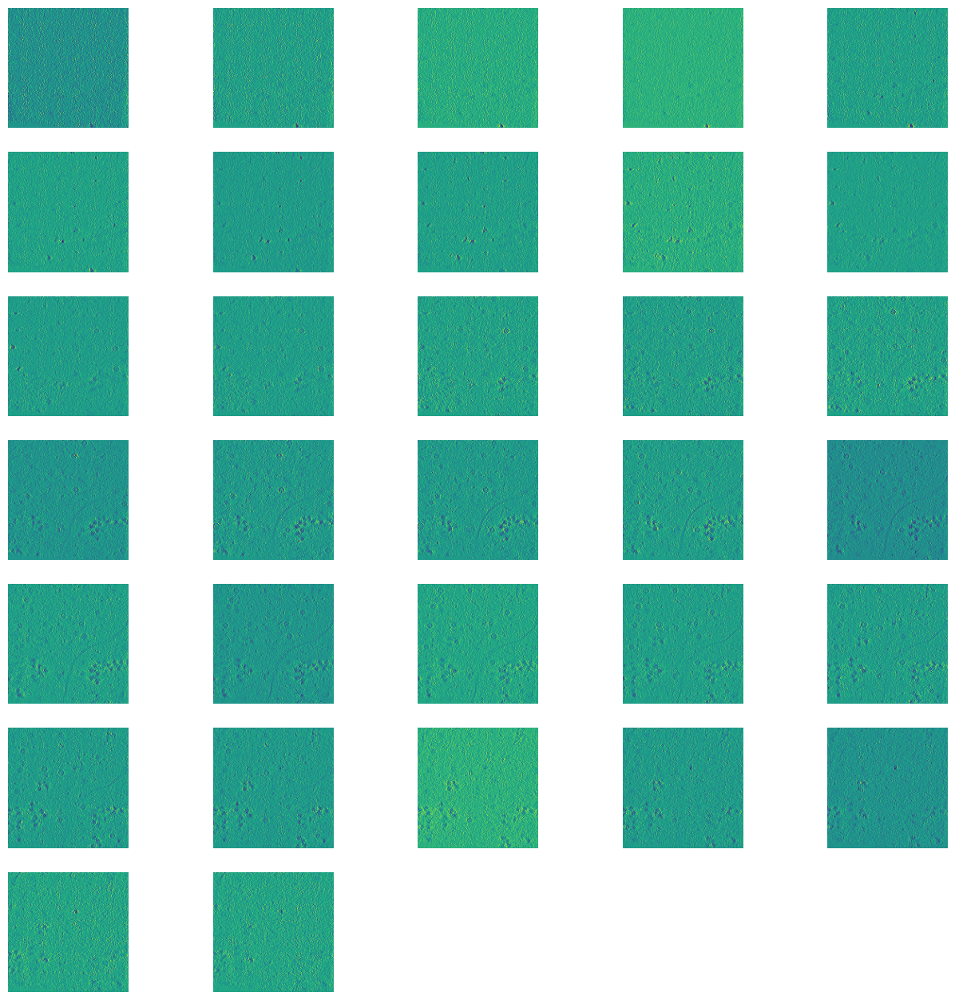

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_99_9\VoxelSpacing10.000\ctfdeconvolved.zarr


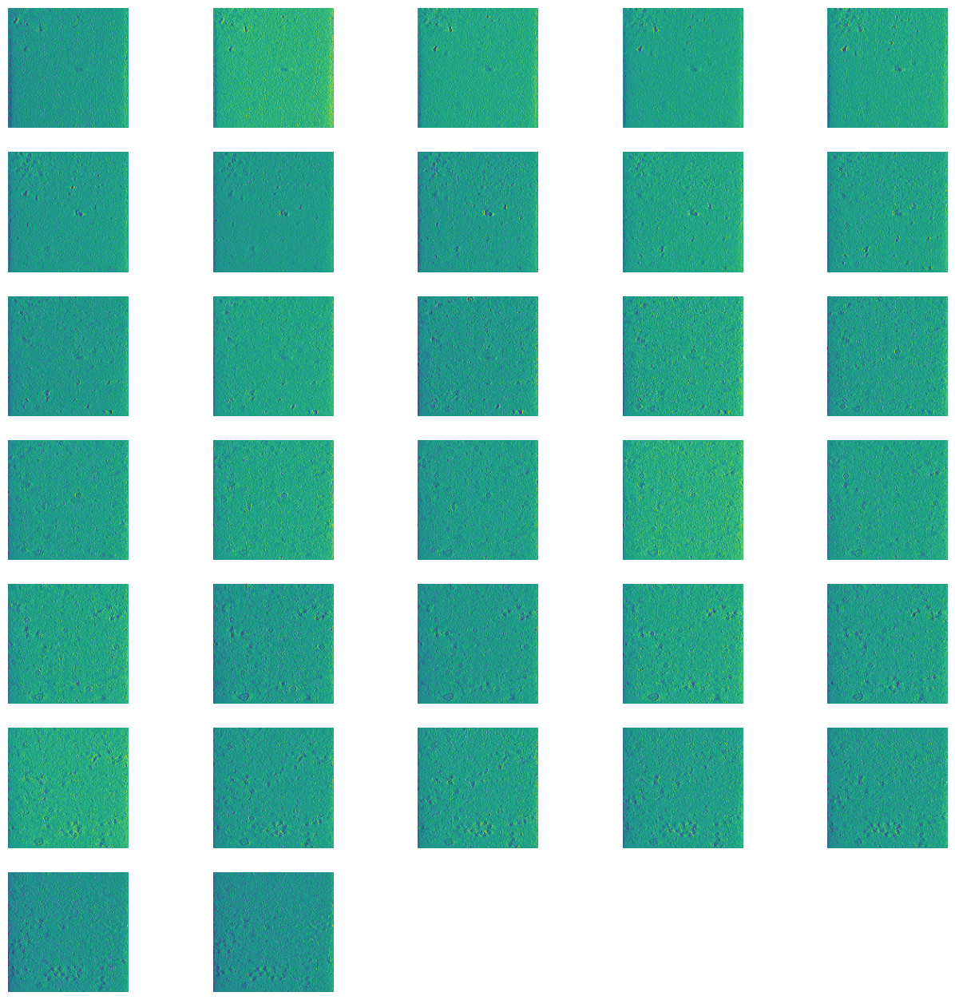

In [10]:
train_static_image_paths = os.listdir(train_images_directory)

static_paths = []

for image_path in train_static_image_paths:
  static_paths += [os.path.join(train_images_directory, image_path, 'VoxelSpacing10.000')]

print(static_paths)

zarr_paths = []
for static_path in static_paths:
  files = os.listdir(static_path)
  zarrs = []
  for file in files:
    zarrs += [os.path.join(static_path, file)]

  zarr_paths += [zarrs]

for i, zarr_path in enumerate(zarr_paths):
  for j, dir in enumerate(zarr_path[0:1]):
    print(zarr_path[j].split('/')[-1])

    data = zarr.open(dir, mode='r')
    
    fig = plt.figure(figsize=(16, 16))

    for k in range(32):
      ax = plt.subplot(7, 5, k + 1)
      plt.axis('off')
      image = data[2][k]
      min_val, max_val = image.min(), image.max()
      simage = ((image - min_val) / (max_val - min_val) * 255).astype('uint8')

      plt.imshow(simage)

      cv2.imwrite(f'image/{i}_{k:02}.png', simage)
    
    plt.show()

# Memory Snapshots

In [22]:
tracemalloc.start()

def print_memory():
  snapshot = tracemalloc.take_snapshot()
  total_memory = sum(stat.size for stat in snapshot.statistics('lineno'))
  total_memory_mb = total_memory / 1024**2

  print(f'{total_memory_mb:.2f} MB')

In [23]:
print_memory()

0.04 MB


In [27]:
prepared_images_directory = 'image'
prepared_mask_directory = 'mask'

In [28]:
prepared_images = os.listdir(prepared_images_directory)

print(prepared_images)

['0_00.png', '0_01.png', '0_02.png', '0_03.png', '0_04.png', '0_05.png', '0_06.png', '0_07.png', '0_08.png', '0_09.png', '0_10.png', '0_11.png', '0_12.png', '0_13.png', '0_14.png', '0_15.png', '0_16.png', '0_17.png', '0_18.png', '0_19.png', '0_20.png', '0_21.png', '0_22.png', '0_23.png', '0_24.png', '0_25.png', '0_26.png', '0_27.png', '0_28.png', '0_29.png', '0_30.png', '0_31.png', '1_00.png', '1_01.png', '1_02.png', '1_03.png', '1_04.png', '1_05.png', '1_06.png', '1_07.png', '1_08.png', '1_09.png', '1_10.png', '1_11.png', '1_12.png', '1_13.png', '1_14.png', '1_15.png', '1_16.png', '1_17.png', '1_18.png', '1_19.png', '1_20.png', '1_21.png', '1_22.png', '1_23.png', '1_24.png', '1_25.png', '1_26.png', '1_27.png', '1_28.png', '1_29.png', '1_30.png', '1_31.png', '2_00.png', '2_01.png', '2_02.png', '2_03.png', '2_04.png', '2_05.png', '2_06.png', '2_07.png', '2_08.png', '2_09.png', '2_10.png', '2_11.png', '2_12.png', '2_13.png', '2_14.png', '2_15.png', '2_16.png', '2_17.png', '2_18.png', '2_

In [29]:
image_size = 512

def read_image(path):
  img = cv2.imread(path)
  img2 = cv2.resize(img, (image_size, image_size))

  return img2

In [30]:
MASKS = np.zeros((1, image_size, image_size, 3), dtype=np.uint8)
IMAGES = np.zeros((1, image_size, image_size, 3), dtype=np.uint8)

for i, file in enumerate(prepared_images[0:100]):
  image = read_image(f'{prepared_images_directory}/{file}')
  image_expand = np.expand_dims(image, axis=0)
  IMAGES = np.vstack([IMAGES, image_expand])

  file2 = file
  mask = read_image(f'{prepared_mask_directory}/{file2}')
  mask_expand = np.expand_dims(mask, axis=0)
  MASKS = np.vstack([MASKS, mask_expand])

In [31]:
images = np.array(IMAGES)[1:101]
masks = np.array(MASKS)[1:101]

print(images.shape, masks.shape)

(100, 512, 512, 3) (100, 512, 512, 3)


In [ ]:
z = zarr.open_group(r'C:\\Users\\pdebasis\source\\personal\\project_3\\czii-cryo-et-object-identification\\train\\static\\ExperimentRuns\\TS_5_4\\VoxelSpacing10.000\\ctfdeconvolved.zarr', mode='r')

list(z.keys())
#print(z.shape)

display(type(z))
#print(z.shape, z.chunks)

zarr.hierarchy.Group

In [4]:
def visit_zarr(group, path=""):
    for key in group.keys():
        current_path = f"{path}/{key}" if path else key
        item = group[key]
        if isinstance(item, zarr.Group):
            print(f"Group: {current_path}")
            visit_zarr(item, current_path)  # Recursive call for nested groups
        elif isinstance(item, zarr.Array):
            print(f"Dataset: {current_path}, Shape: {item.shape}, Dtype: {item.dtype}")

In [5]:
visit_zarr(z)

Dataset: 0, Shape: (184, 630, 630), Dtype: float32
Dataset: 1, Shape: (92, 315, 315), Dtype: float32
Dataset: 2, Shape: (46, 158, 158), Dtype: float32


In [6]:
display(z.tree())

Tree(nodes=(Node(disabled=True, name='/', nodes=(Node(disabled=True, icon='table', name='0 (184, 630, 630) flo…

In [7]:
for key in z.keys():
  print('Data shape: ', z[key].shape)
  print('Data type: ', z[key].dtype)
  print('Array attributes', z[key].attrs)


Data shape:  (184, 630, 630)
Data type:  float32
Array attributes <zarr.attrs.Attributes object at 0x00000200E59F2270>
Data shape:  (92, 315, 315)
Data type:  float32
Array attributes <zarr.attrs.Attributes object at 0x00000200E5C142F0>
Data shape:  (46, 158, 158)
Data type:  float32
Array attributes <zarr.attrs.Attributes object at 0x00000200E5C149E0>


Text(0.5, 1.0, 'Slice 0 of data')

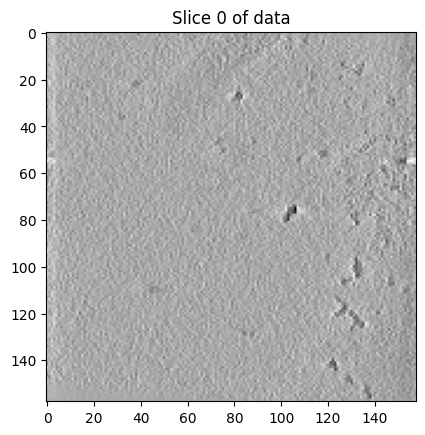

In [8]:
sliced_data = z[key][0, :, :]

plt.imshow(sliced_data, cmap='gray')
plt.title(f'Slice 0 of data')

In [9]:
for key in z.keys():
  if isinstance(z[key], zarr.Group):
    print(f'{key} is a group')
  elif isinstance(z[key], zarr.Array):
    print(f'{key} is an array')

0 is an array
1 is an array
2 is an array


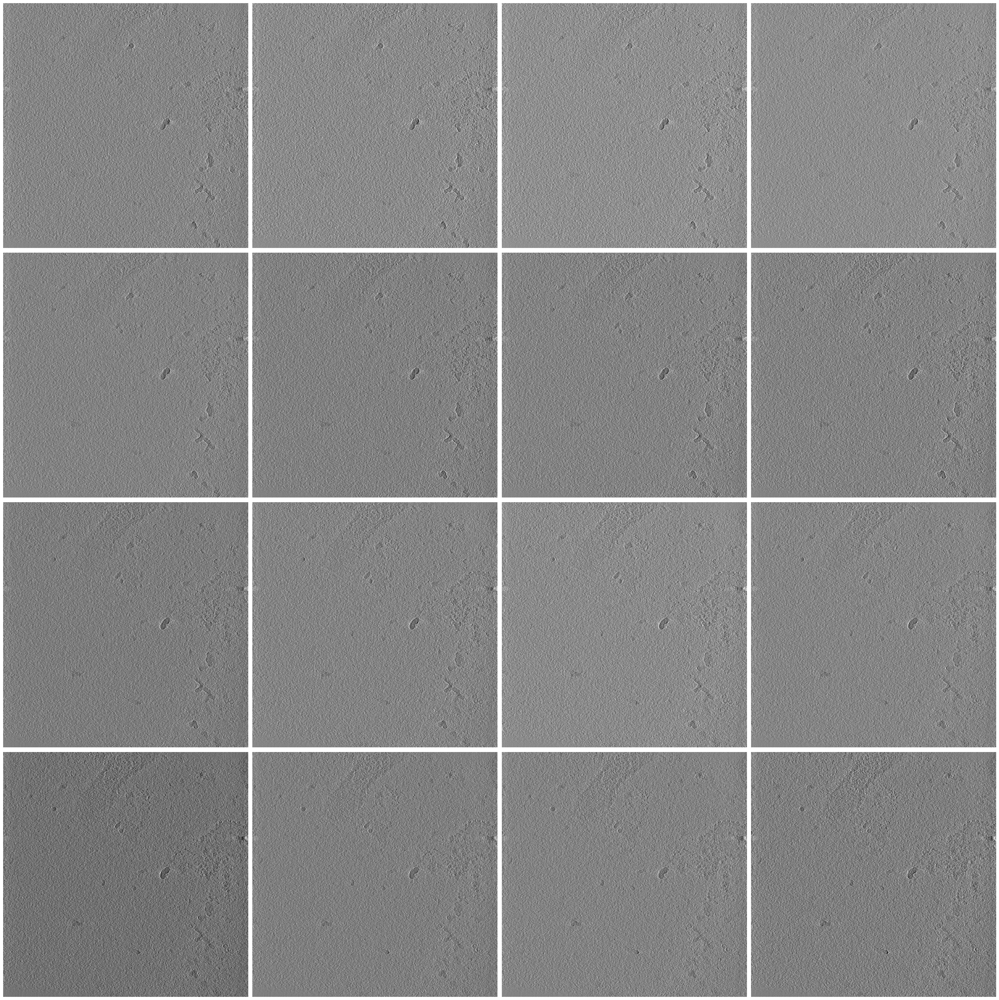

In [10]:
total_slices = slice(0, 100)

selected_slices = z[0]

total_slices = 16 #z[0].shape[0]
indices = 16 #range(z[0].shape[0])

columns = math.ceil(math.sqrt(total_slices))

rows = math.ceil(total_slices / columns)

fig, axes = plt.subplots(rows, columns, figsize=(32,32))

for i in range(rows * columns):
  if (i < total_slices):
    sliced_data = selected_slices[i, :, :]
    ax = axes[i // columns, i% columns]
    ax.imshow(sliced_data, cmap='gray')
    ax.axis('off')
  else:
    axes[i // columns, i % columns].axis('off')


plt.tight_layout()
plt.show()


In [32]:
json_paths = []

for dirname, _, filenames in os.walk(train_images_path):
  for filename in filenames:
    json_paths.append(os.path.join(dirname, filename))

print(json_paths[0])

C:\Users\pdebasis\source\personal\project_3\czii-cryo-et-object-identification\train\static\ExperimentRuns\TS_5_4\VoxelSpacing10.000\ctfdeconvolved.zarr\.zattrs


In [30]:
random_images = np.random(json_paths)

['ExperimentRuns']

In [ ]:
json_data_all = []

for path in json_paths:
  json_data = util.read_json(path)
  #print(json_data)
  json_data_all.append(json_data)

json_df = util.json_to_df(json_data_all)

display(json_df)

UnicodeDecodeError: 'charmap' codec can't decode byte 0x8d in position 98: character maps to <undefined>

In [11]:
"""
Derived from:
https://github.com/cellcanvas/album-catalog/blob/main/solutions/copick/compare-picks/solution.py
"""

import numpy as np
import pandas as pd

from scipy.spatial import KDTree


class ParticipantVisibleError(Exception):
    pass


def compute_metrics(reference_points, reference_radius, candidate_points):
    num_reference_particles = len(reference_points)
    num_candidate_particles = len(candidate_points)

    if len(reference_points) == 0:
        return 0, num_candidate_particles, 0

    if len(candidate_points) == 0:
        return 0, 0, num_reference_particles

    ref_tree = KDTree(reference_points)
    candidate_tree = KDTree(candidate_points)
    raw_matches = candidate_tree.query_ball_tree(ref_tree, r=reference_radius)
    matches_within_threshold = []
    for match in raw_matches:
        matches_within_threshold.extend(match)
    # Prevent submitting multiple matches per particle.
    # This won't be be strictly correct in the (extremely rare) case where true particles
    # are very close to each other.
    matches_within_threshold = set(matches_within_threshold)
    tp = int(len(matches_within_threshold))
    fp = int(num_candidate_particles - tp)
    fn = int(num_reference_particles - tp)
    return tp, fp, fn


def score(
        solution: pd.DataFrame,
        submission: pd.DataFrame,
        row_id_column_name: str,
        distance_multiplier: float,
        beta: int) -> float:
    '''
    F_beta
      - a true positive occurs when
         - (a) the predicted location is within a threshold of the particle radius, and
         - (b) the correct `particle_type` is specified
      - raw results (TP, FP, FN) are aggregated across all experiments for each particle type
      - f_beta is calculated for each particle type
      - individual f_beta scores are weighted by particle type for final score
    '''

    particle_radius = {
        'apo-ferritin': 60,
        'beta-amylase': 65,
        'beta-galactosidase': 90,
        'ribosome': 150,
        'thyroglobulin': 130,
        'virus-like-particle': 135,
    }

    weights = {
        'apo-ferritin': 1,
        'beta-amylase': 0,
        'beta-galactosidase': 2,
        'ribosome': 1,
        'thyroglobulin': 2,
        'virus-like-particle': 1,
    }

    particle_radius = {k: v * distance_multiplier for k, v in particle_radius.items()}

    # Filter submission to only contain experiments found in the solution split
    split_experiments = set(solution['experiment'].unique())
    submission = submission.loc[submission['experiment'].isin(split_experiments)]

    # Only allow known particle types
    if not set(submission['particle_type'].unique()).issubset(set(weights.keys())):
        raise ParticipantVisibleError('Unrecognized `particle_type`.')

    assert solution.duplicated(subset=['experiment', 'x', 'y', 'z']).sum() == 0
    assert particle_radius.keys() == weights.keys()

    results = {}
    for particle_type in solution['particle_type'].unique():
        results[particle_type] = {
            'total_tp': 0,
            'total_fp': 0,
            'total_fn': 0,
        }

    for experiment in split_experiments:
        for particle_type in solution['particle_type'].unique():
            reference_radius = particle_radius[particle_type]
            select = (solution['experiment'] == experiment) & (solution['particle_type'] == particle_type)
            reference_points = solution.loc[select, ['x', 'y', 'z']].values

            select = (submission['experiment'] == experiment) & (submission['particle_type'] == particle_type)
            candidate_points = submission.loc[select, ['x', 'y', 'z']].values

            if len(reference_points) == 0:
                reference_points = np.array([])
                reference_radius = 1

            if len(candidate_points) == 0:
                candidate_points = np.array([])

            tp, fp, fn = compute_metrics(reference_points, reference_radius, candidate_points)

            results[particle_type]['total_tp'] += tp
            results[particle_type]['total_fp'] += fp
            results[particle_type]['total_fn'] += fn

    aggregate_fbeta = 0.0
    for particle_type, totals in results.items():
        tp = totals['total_tp']
        fp = totals['total_fp']
        fn = totals['total_fn']

        precision = tp / (tp + fp) if tp + fp > 0 else 0
        recall = tp / (tp + fn) if tp + fn > 0 else 0
        fbeta = (1 + beta**2) * (precision * recall) / (beta**2 * precision + recall) if (precision + recall) > 0 else 0.0
        aggregate_fbeta += fbeta * weights.get(particle_type, 1.0)

    if weights:
        aggregate_fbeta = aggregate_fbeta / sum(weights.values())
    else:
        aggregate_fbeta = aggregate_fbeta / len(results)
    return aggregate_fbeta

